# Проект: Поиск по изображениям


## О проекте

__Заказчик__: фотохостинг для профессиональных фотографов «Со Смыслом» (“With Sense”).

__Описание задачи__

Пользователи размещают свои фотографии на хостинге и сопровождают их полным описанием. Описание может предоставить не только тот, кто размещает фотографию, но и другие пользователи портала.

Проводится эксперимент по разработке поиска референсных фотографий для фотографов. Суть поиска заключается в следующем: пользователь сервиса вводит описание нужной сцены. Сервис выводит несколько фотографий с такой же или похожей сценой.

Для защиты проекта необходимо презентовать PoC (Proof of Concept, Проверка концепции) — продемонстрировать, что такой проект практически осуществим.

__Цель проекта__:

 Разработать демонстрационную версию поиска изображений по запросу. Для демонстрационной версии нужно выбрать лучшую  модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — и покажет, насколько текст и картинка подходят друг другу.

__Юридические ограничения__:

В некоторых странах, где работает компания With Sense, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно, текстов, изображений, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16-ти лет.
В сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:
> This image is unavailable in your country in compliance with local laws.

Однако в PoC нет возможности воспользоваться данным функционалом. Поэтому необходимо очистить данные от проблемного контента. Во время тестирования модели при появлении в запросе “вредного” контента должен отображаться дисклеймер.


__Описание данных__:

● __train_dataset.csv__

В файле train_dataset.csv находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.

● __train_images__

В папке train_images содержатся изображения для тренировки модели.

● __CrowdAnnotations.tsv__

В файле CrowdAnnotations.tsv  — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:
1. Имя файла изображения.
2. Идентификатор описания.
3. Доля людей, подтвердивших, что описание соответствует изображению.
4. Количество человек, подтвердивших, что описание соответствует изображению.
5. Количество человек, подтвердивших, что описание не соответствует изображению.

● __ExpertAnnotations.tsv__

В файле ExpertAnnotations.tsv  — данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

1 -  Имя файла изображения.

2 -  Идентификатор описания.

3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.      

● __test_queries.csv__

В файле test_queries.csv находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.

● __test_images__

В папке test_images содержатся изображения для тестирования модели.

__Требования к решению:__

При решении задачи необходимо использовать только один фреймворк Pytorch или Keras.

__Метрика__: RMSE

## Подготовка к проекту

### Установка библиотек

In [1]:
#!pip install -q contractions

In [2]:
#!pip install -q -U sentence-transformers

### Импортирование библиотек и функций

In [ ]:
import os
import random
import re
from math import ceil

import contractions
import cv2
import glob
import matplotlib.pyplot as plt
import nltk
import numpy as np
import pandas as pd
import seaborn as sns
from nltk import pos_tag, word_tokenize
from nltk.stem import WordNetLemmatizer
from PIL import Image
from tqdm.notebook import tqdm

from lightgbm import LGBMRegressor
from sklearn.dummy import DummyRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GroupShuffleSplit, GridSearchCV
from sklearn.preprocessing import StandardScaler

from sentence_transformers import SentenceTransformer, util
import torch
import torch.nn as nn
import torchvision.models as models
from torchvision import transforms
import transformers

### Константы

In [ ]:
RANDOM_STATE = 42
TEST_IMAGES_PATH = '/content/data/to_upload/test_images/'
TRAIN_IMAGES_PATH = '/content/data/to_upload/train_images/'
FILES_PATH = '/content/data/to_upload/'

FORBIDDEN_WORDS = ['child', 'kid', 'infant', 'newborn', 'toddler', 'baby',
                   'juvenile', 'adolescent', 'teen', 'teenager', 'girl', 'boy']

DISCLAMER = "This image is unavailable in your country in compliance with local laws."

### Прочие загрузки

In [ ]:
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('averaged_perceptron_tagger_eng')

tqdm.pandas()

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.


## Загрузка и анализ данных

### Загрузка данных

In [ ]:
# скачивание файла
!gdown "https://drive.google.com/uc?id=1TirfBKVLiXe-xZgJLXUSN4JNrqpKpTKd" -O data_folder.zip
# распаковка архива
!unzip -q data_folder.zip -d /content/data
# проверка содержимого
!ls /content/data/to_upload/

Downloading...
From (original): https://drive.google.com/uc?id=1TirfBKVLiXe-xZgJLXUSN4JNrqpKpTKd
From (redirected): https://drive.google.com/uc?id=1TirfBKVLiXe-xZgJLXUSN4JNrqpKpTKd&confirm=t&uuid=f9fb55c6-5d4c-4ca7-8909-44b4219f2736
To: /content/data_folder.zip
100% 150M/150M [00:03<00:00, 49.8MB/s]
CrowdAnnotations.tsv   test_images	test_queries.csv   train_images
ExpertAnnotations.tsv  test_images.csv	train_dataset.csv


Названия файлов соответствуют описанию.

### train_images, test_images

In [ ]:
def get_unique_extensions(folder_path):
    """
    Возвращает список уникальных расширений изображений в указанной папке.

    Args:
        folder_path (str): Путь к папке с изображениями.

    Returns:
        list: Список уникальных расширений изображений.
    """
    extensions = set()
    for filename in os.listdir(folder_path):
        if os.path.isfile(os.path.join(folder_path, filename)):
            ext = os.path.splitext(filename)[1]
            if ext:
                extensions.add(ext)
    return sorted(extensions)

In [ ]:
def has_subdirectories(path):
    """
    Проверяет, есть ли поддиректории в указанной папке

    Args:
        path (str): Путь к папке.

    Returns:
        bool True/False
    """
    for entry in os.scandir(path):
        if entry.is_dir():
            return True
    return False

In [ ]:
print(f'Расширения файлов в папке {TRAIN_IMAGES_PATH}: {get_unique_extensions(TRAIN_IMAGES_PATH)}')
print(f'Подпапки в папке {TRAIN_IMAGES_PATH}: {has_subdirectories(TRAIN_IMAGES_PATH)}')

Расширения файлов в папке /content/data/to_upload/train_images/: ['.jpg']
Подпапки в папке /content/data/to_upload/train_images/: False


In [ ]:
print(f'Расширения файлов в папке {TEST_IMAGES_PATH}: {get_unique_extensions(TRAIN_IMAGES_PATH)}')
print(f'Подпапки в папке {TEST_IMAGES_PATH}: {has_subdirectories(TEST_IMAGES_PATH)}')

Расширения файлов в папке /content/data/to_upload/test_images/: ['.jpg']
Подпапки в папке /content/data/to_upload/test_images/: False


In [ ]:
!find {TRAIN_IMAGES_PATH} -type f -name "*.jpg" | wc -l

1000


In [ ]:
!find {TEST_IMAGES_PATH} -type f -name "*.jpg" | wc -l

100


In [ ]:
def show_10_images(folder_path):
    """
    Отображает 10 изображений из указанной папки. Если в папке меньше 10
    изображений, отображаются все изображения.

    Args:
        folder_path: путь к папке с изображениями

    Returns:
        None
    """

    image_files = [os.path.join(folder_path, f) \
                   for f in os.listdir(folder_path) if f.endswith('.jpg')]

    for i in range(min(10, len(image_files))):
        image = cv2.imread(image_files[i])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

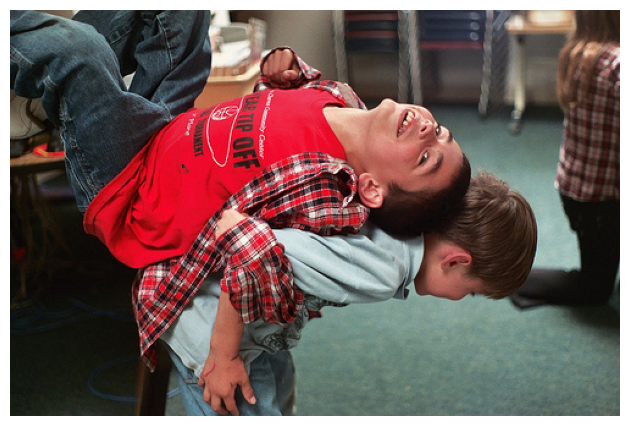

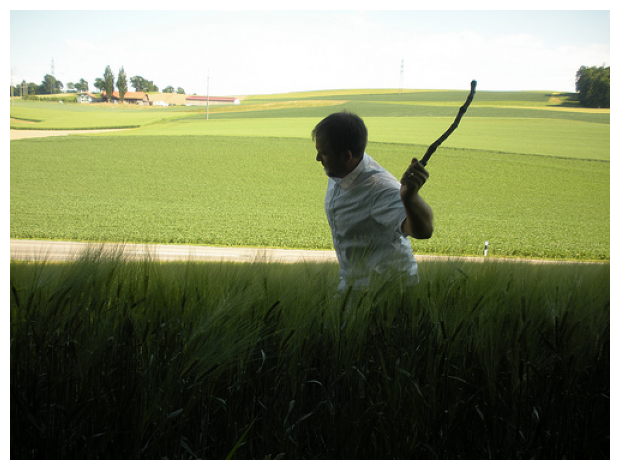

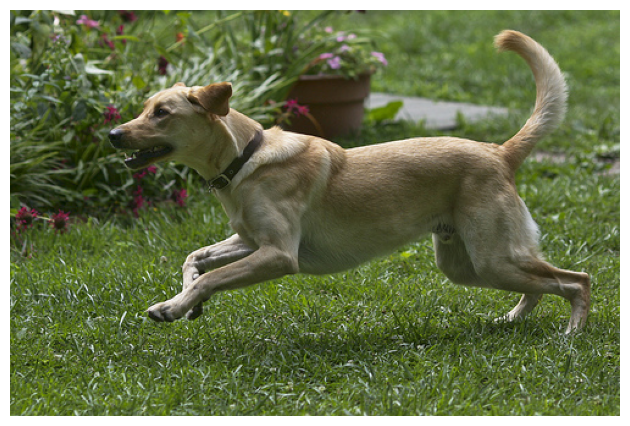

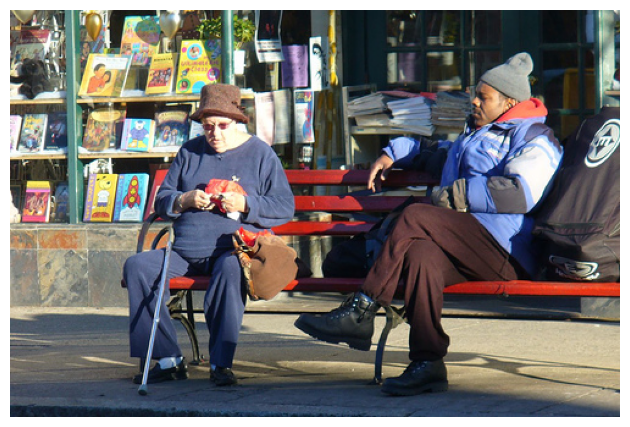

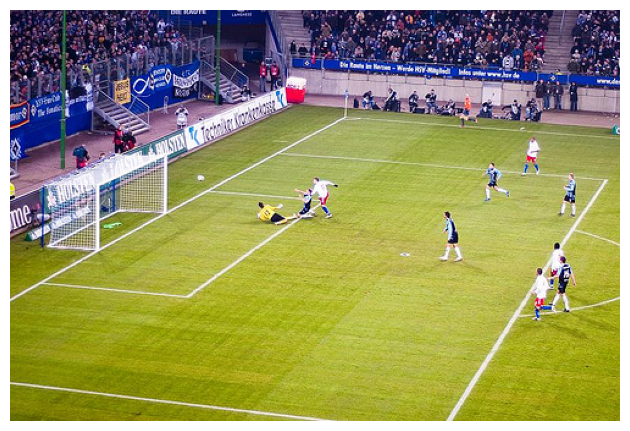

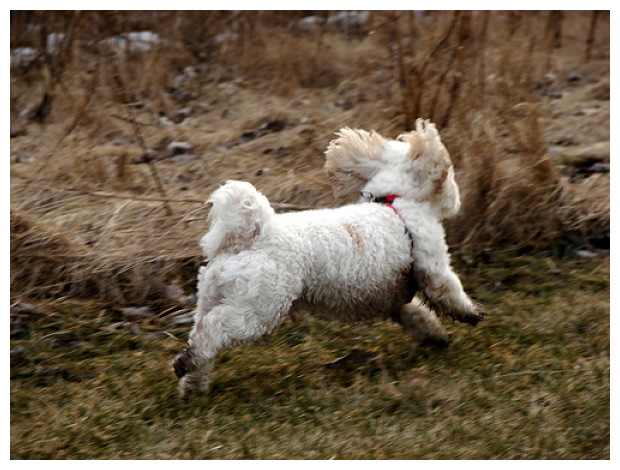

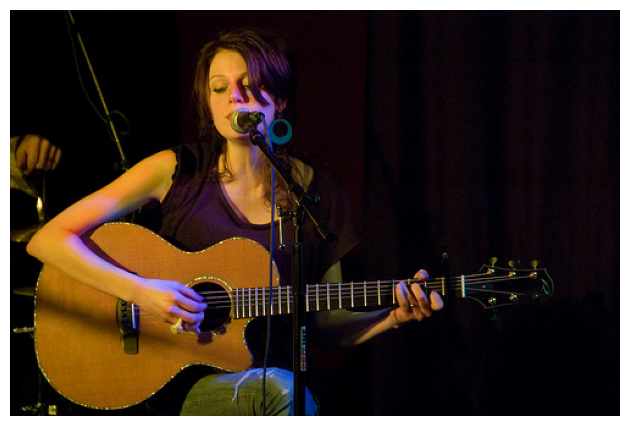

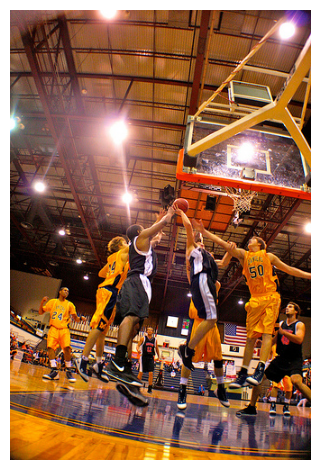

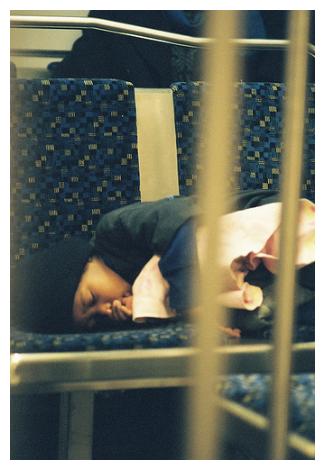

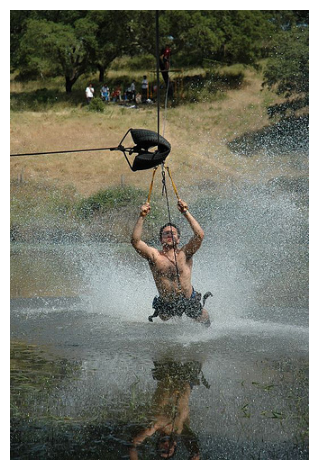

In [ ]:
show_10_images(TRAIN_IMAGES_PATH)

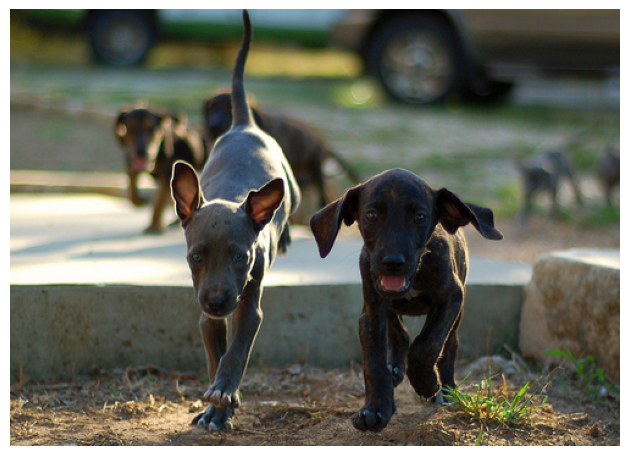

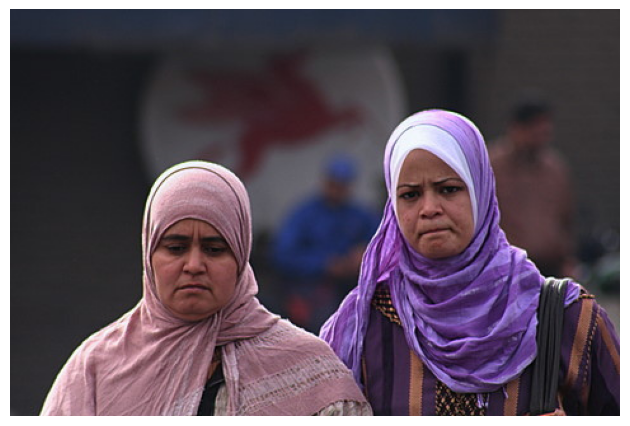

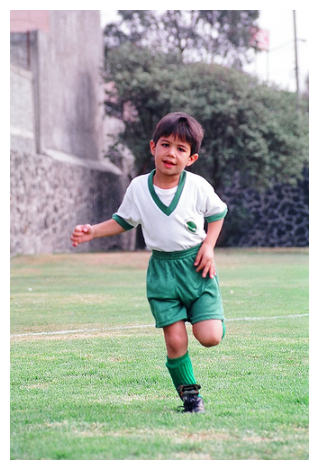

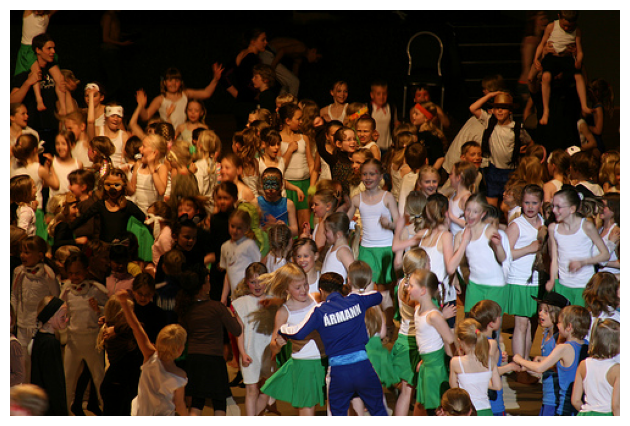

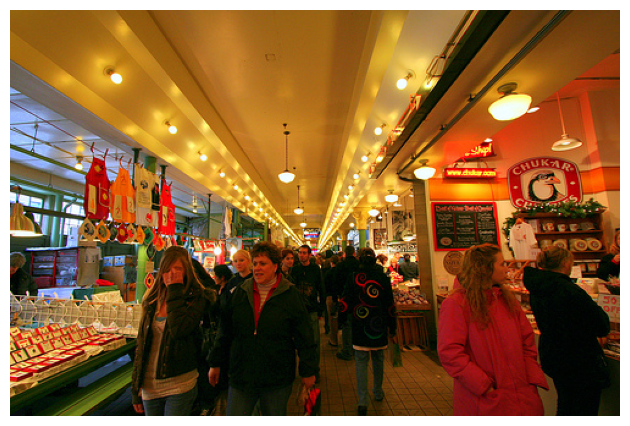

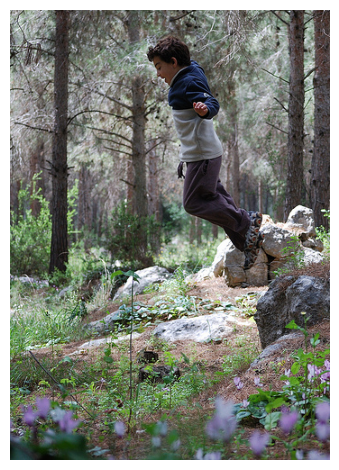

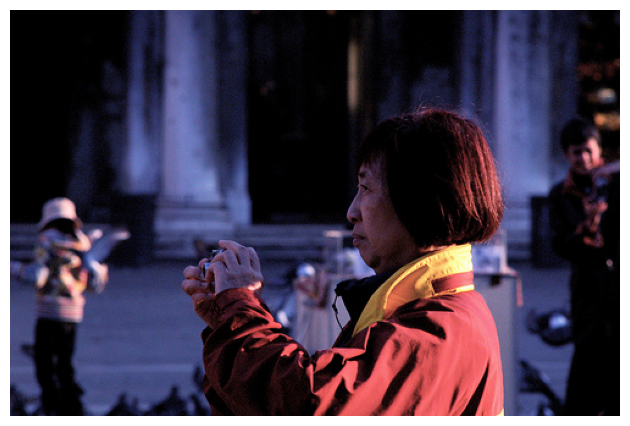

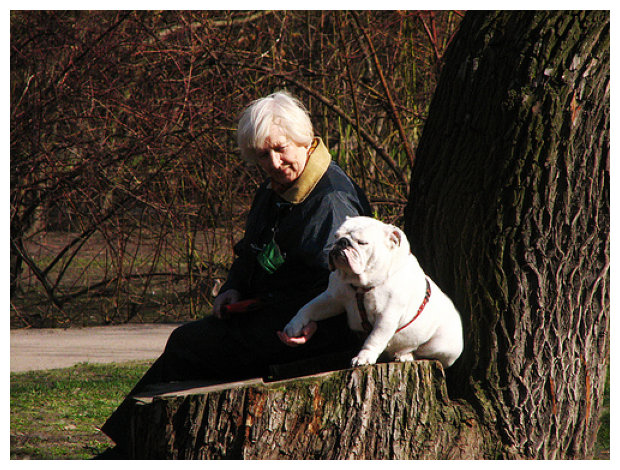

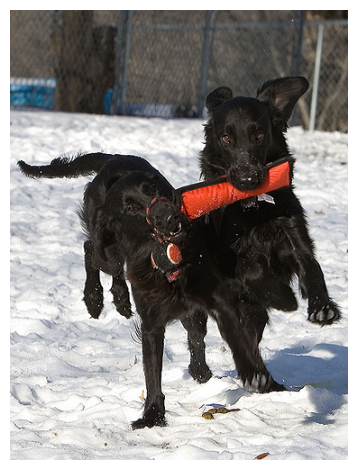

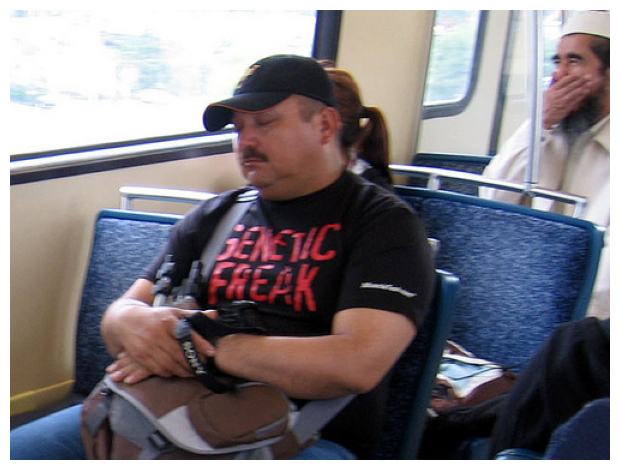

In [ ]:
show_10_images(TEST_IMAGES_PATH)

Нам предоставлены 1000 тренировочных и 100 тестовых изображений, расширение файлов 'jpg', поддиректорий нет. Встречаются как фотографии взрослых, так и фотографии детей. Требуется очистить данные до начала их использования.

### train_dataset.csv

In [ ]:
train_dataset = pd.read_csv(FILES_PATH + 'train_dataset.csv')
train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [ ]:
int(train_dataset.duplicated().sum())

0

In [ ]:
train_dataset.head(10)

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
5,3030566410_393c36a6c5.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
8,343218198_1ca90e0734.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
9,3718964174_cb2dc1615e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


Согласно описанию данных, идентификатор описания (столбец `query_id`) имеет формат <имя файла изображения>#<порядковый номер описания>.

In [ ]:
def check_parts_of_query_id(row):
    """
    Функция проверяет, соответстветствует ли image первой части query_id.

    Args:
        row: Строка из датасета.

    Returns:
        bool
    """
    if row['image'] == row['query_id'].split('#')[0]:
        return True
    else:
        return False

In [ ]:
train_dataset.apply(check_parts_of_query_id, axis=1).mean()

np.float64(0.027138440398488492)

In [ ]:
train_dataset.nunique()

,0
image,1000
query_id,977
query_text,977


In [ ]:
set_of_images_from_dataset = set(train_dataset['image'])
set_of_images_from_folder = {
    f for f in os.listdir(TRAIN_IMAGES_PATH)
    if not f.startswith('.')}
set_of_images_from_folder == set(set_of_images_from_folder)

True

Тренировочный датасет содержит 5822 строки, дубликатов нет, типы данных определены верно, названия столбцов записаны в змеиной нотации. Датасет содержит описания для 1000 изображений, расположенных в папке train_images, уникальных описаний - 977. Если исходить из формата записей, то у нас всего 2.7% данных, где изображение соответсвует описанию.

In [ ]:
def show_n_pairs_of_images(data, n, folder_path):
    """
    Отображает N пар изображений (реальное и результат) с текстовым запросом.

    Args:
        data: DataFrame с колонками ['query_id', 'image', 'query_text']
        n: количество пар для отображения
        folder_path: путь к папке с изображениями

    Returns:
        None
    """
    for i in range(n):

        real_image_path = os.path.join(folder_path,
                                       data.iloc[i]['query_id'].split('#')[0])
        shown_image_path = os.path.join(folder_path, data.iloc[i]['image'])

        if (not os.path.exists(real_image_path) or
            not os.path.exists(shown_image_path)):
            print(f"Пропуск пары: отсутствуют файлы {real_image_path},\
                       {shown_image_path}")
        else:
            plt.figure()
            plt.suptitle(f"Запрос: {data.iloc[i]['query_text']}",
                         y=1.05, fontsize=12)
            plt.subplot(1, 2, 1)
            real_img = cv2.cvtColor(cv2.imread(real_image_path),
                                    cv2.COLOR_BGR2RGB)
            plt.imshow(real_img)
            plt.title("Реальное изображение")
            plt.axis('off')

            plt.subplot(1, 2, 2)
            shown_img = cv2.cvtColor(cv2.imread(shown_image_path),
                                     cv2.COLOR_BGR2RGB)
            plt.imshow(shown_img)
            plt.title("Показанное изображение")
            plt.axis('off')

            plt.tight_layout()
            plt.show()

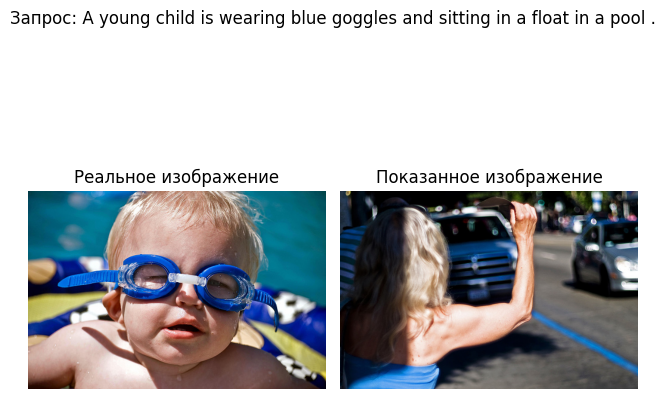

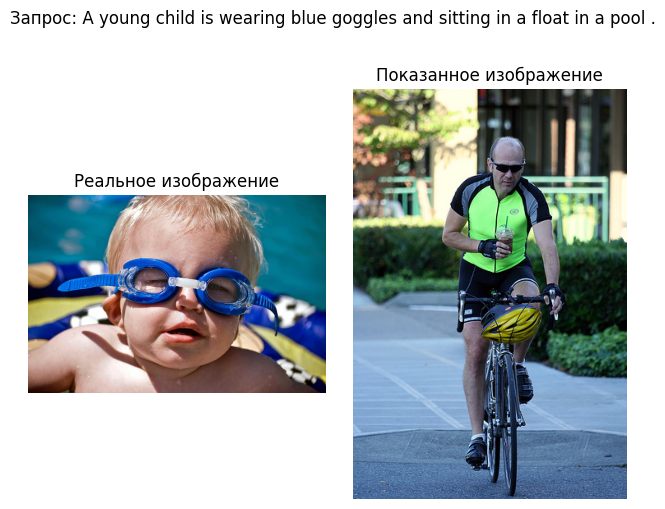

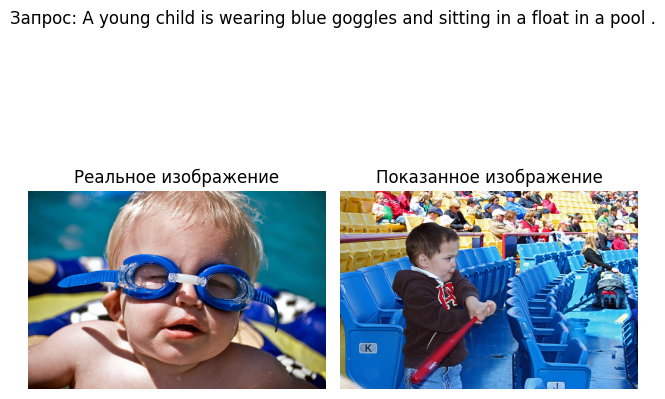

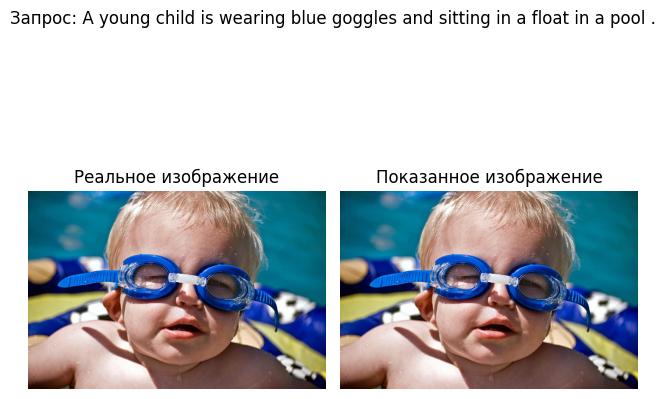

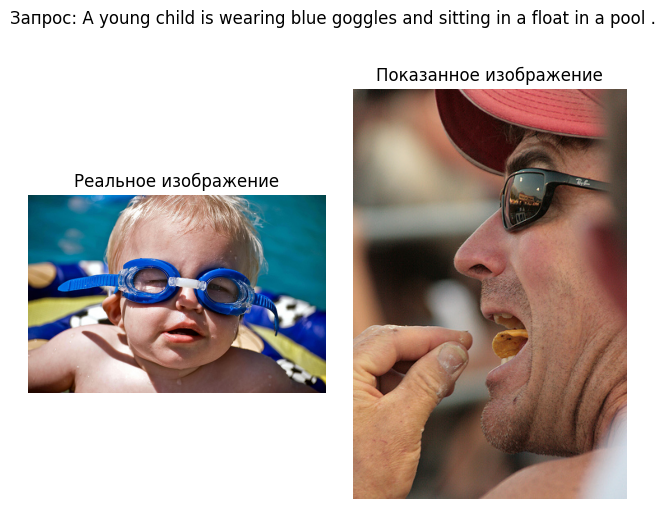

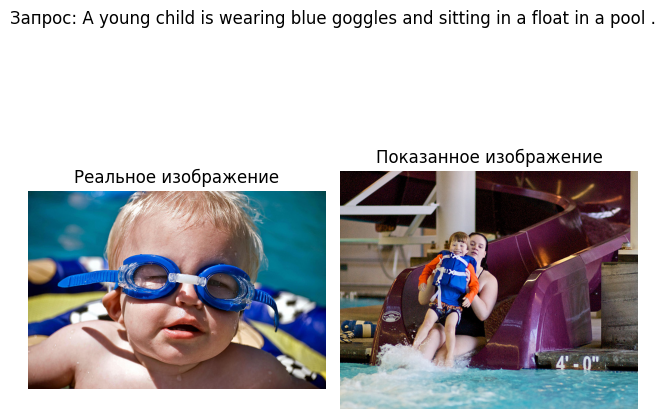

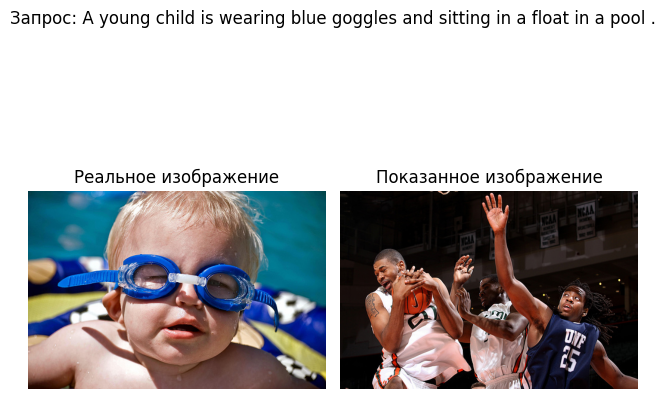

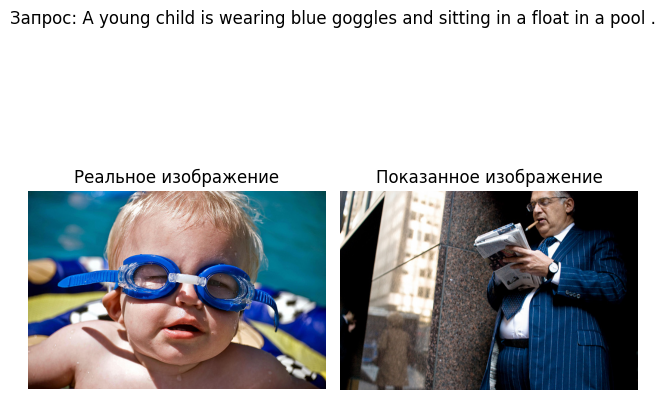

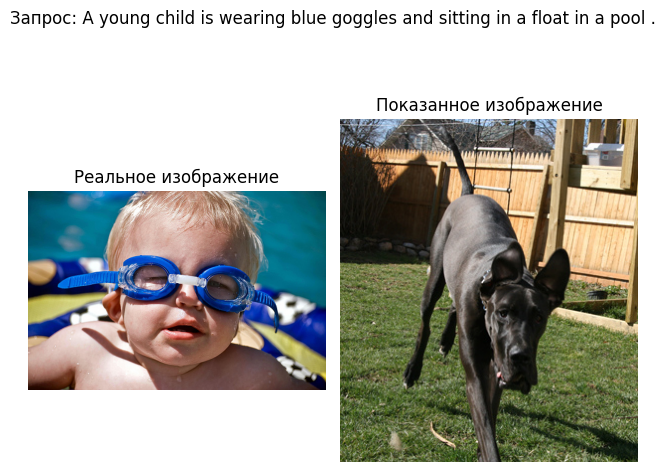

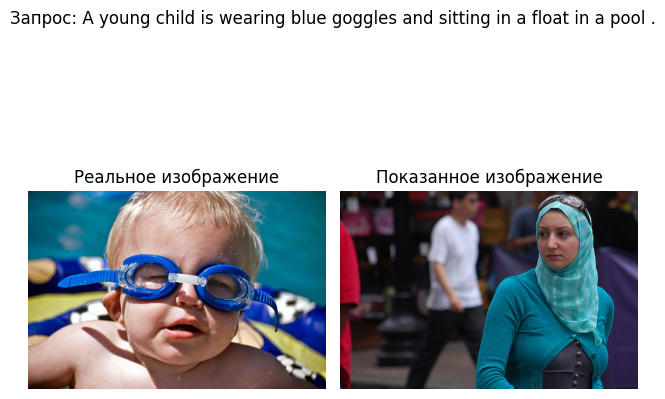

In [ ]:
show_n_pairs_of_images(train_dataset, 10, TRAIN_IMAGES_PATH)

Как и указано в описании данных, идентификатор описания содержит данные о реальном изображении, соотвествующем описанию.

### test_queries.csv

In [ ]:
test_queries = pd.read_csv(FILES_PATH + 'test_queries.csv',
                           sep='|', index_col=0)
test_queries.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


In [ ]:
int(test_queries.duplicated().sum())

0

In [ ]:
test_queries.head()

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


In [ ]:
test_queries.apply(check_parts_of_query_id, axis=1).mean()

np.float64(1.0)

In [ ]:
test_queries.nunique()

,0
query_id,500
query_text,500
image,100


In [ ]:
set_of_images_from_dataset = set(test_queries['image'])
set_of_images_from_folder = {
    f for f in os.listdir(TEST_IMAGES_PATH)
    if not f.startswith('.')}
set_of_images_from_folder == set(set_of_images_from_folder)

True

Тестовый датасет содержит 500 строк, пропусков и дубликатов нет, типы данных определены верно, названия столбцов записаны в змеиной нотации. Все изображения соответсвуют описанию (исходя из формата записей). Датасет содержит информацию о 100 уникальных изображениях, расположенных в папке test_images, и 500 уникальных описаний.

### CrowdAnnotations.tsv

Теперь изучим файлы с оценками описаний.

In [ ]:
crowd_annotations = pd.read_csv(FILES_PATH + 'CrowdAnnotations.tsv',
                                sep='\t', header=None,
                                names=['image', 'query_id', 'share',
                                       'agree', 'disagree'])
crowd_annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     47830 non-null  object 
 1   query_id  47830 non-null  object 
 2   share     47830 non-null  float64
 3   agree     47830 non-null  int64  
 4   disagree  47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [ ]:
crowd_annotations.head()

,image,query_id,share,agree,disagree
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


In [ ]:
crowd_annotations.duplicated().sum()

np.int64(0)

In [ ]:
crowd_annotations.describe()

,share,agree,disagree
count,47830.000000,47830.000000,47830.000000
mean,0.068786,0.208488,2.820155
std,0.207532,0.628898,0.656676
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,3.000000
50%,0.000000,0.000000,3.000000
75%,0.000000,0.000000,3.000000
max,1.000000,5.000000,6.000000


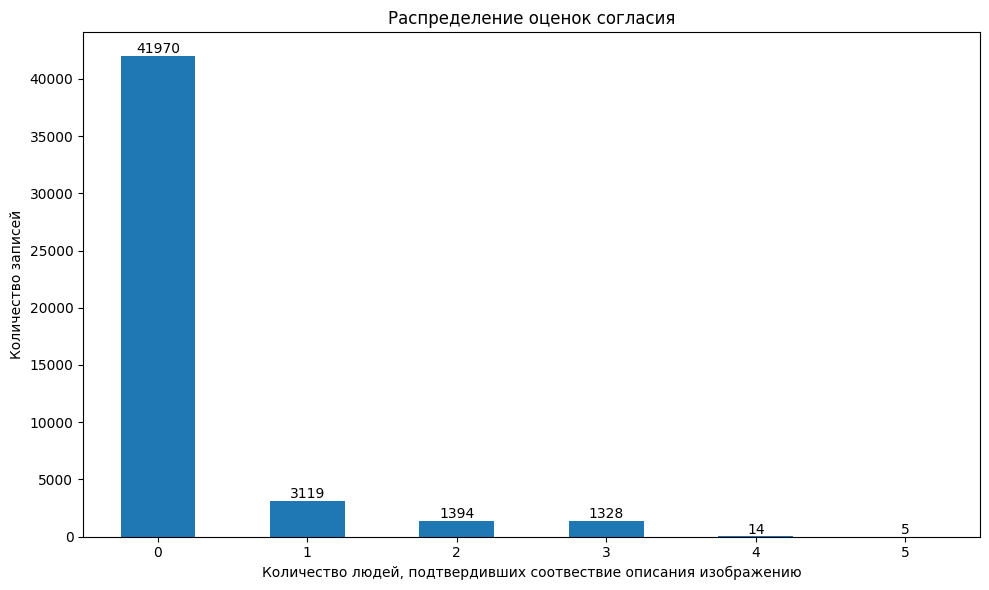

In [ ]:
# Создаем фигуру
plt.figure(figsize=(10, 6))

# Строим bar plot
ax = crowd_annotations['agree'].value_counts().sort_index().plot.bar()

# Добавляем подписи с количеством над каждым столбцом
for p in ax.patches:
    ax.annotate(f"{int(p.get_height())}",
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 5),
                textcoords='offset points')

# Настройки графика
plt.title('Распределение оценок согласия')
plt.xlabel('Количество людей, подтвердивших соотвествие описания изображению')
plt.ylabel('Количество записей')
plt.xticks(rotation=0)  # Горизонтальные подписи на оси X

# Отображаем график
plt.tight_layout()
plt.show()

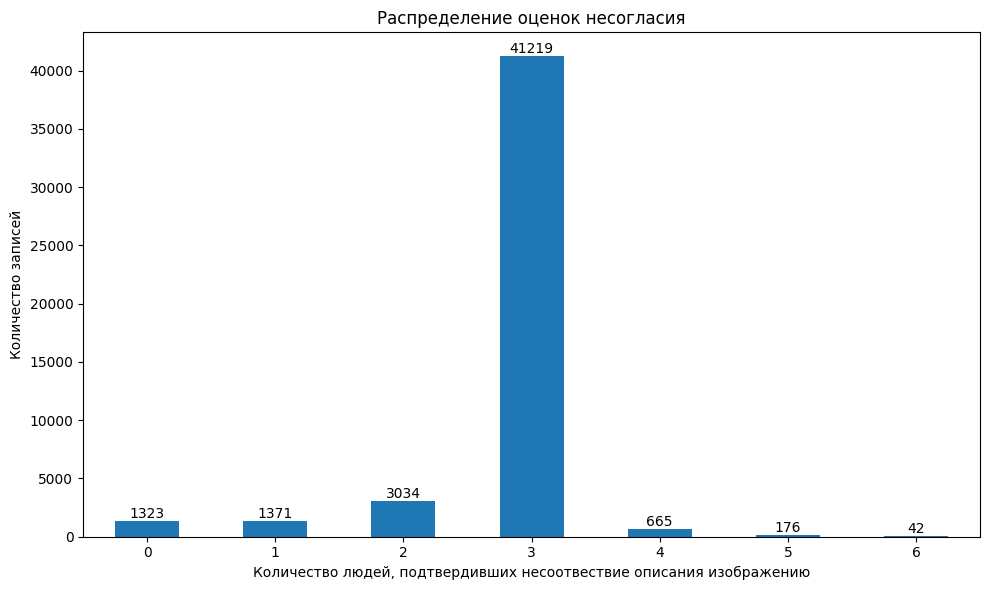

In [ ]:
plt.figure(figsize=(10, 6))

ax = crowd_annotations['disagree'].value_counts().sort_index().plot.bar()

# Добавляем подписи с количеством над каждым столбцом
for p in ax.patches:
    ax.annotate(f"{int(p.get_height())}",
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 5),
                textcoords='offset points')

plt.title('Распределение оценок несогласия')
plt.xlabel('Количество людей, подтвердивших несоотвествие описания изображению')
plt.ylabel('Количество записей')
plt.xticks(rotation=0)

plt.tight_layout()
plt.show()

In [ ]:
crowd_annotations['share'].mean()

np.float64(0.06878562966060352)

In [ ]:
def check_complete_match(df1, df2, key_columns=['image', 'query_id']):
    """
    Проверяет, что все комбинации значений ключевых столбцов из df1
    присутствуют в df2. Выводит подробный отчет о проверке.

    Параметры:
    - df1: первый датасет (исходные данные)
    - df2: второй датасет (справочные данные)
    - key_columns: список столбцов для сравнения

    """

    merged = df1[['image', 'query_id']].merge(
        df2[['image', 'query_id']],
        how='inner',
        on=['image', 'query_id'])

    if len(merged) == len(df1):
        print("Все строки присутствуют")
    else:
        print(f"Отсутствует {len(df1) - len(merged)} строк")

In [ ]:
check_complete_match(train_dataset, crowd_annotations)

Отсутствует 3493 строк


In [ ]:
def analyze_numerical_data(data, column, title, bins_number=100):
    """
    Функция помогает при проведении статистического анализа количественных
     признаков.

    Принимает датасет, столбец для анализа и значение заголовка
    для вывода графика. Может принимать bins для построения графика.

    Выводит для колонки:
    - гистограмму с отмеченным средним значением и медианой
    - диаграмму размаха

    Args:
        data (pd.DataFrame): Датасет.
        column (str): Колонка для анализа.
        title (str): Заголовок для вывода графика.
        bins_number (int, optional): Количество интервалов для гистограммы.

    Returns:
        None
    """

    median = data[column].median()
    mean = data[column].mean()

    # Создаем фигуру и оси для гистограммы
    fig, ax = plt.subplots(2, 1, figsize=(17, 10))

    # Гистограмма
    ax[0].hist(data[column], bins=bins_number, color='skyblue')
    ax[0].set_title(f'Гистограмма для признака "{title}"', fontsize=16)
    ax[0].set_xlabel(title, fontsize=14)
    ax[0].set_ylabel('Частота', fontsize=14)
    ax[0].grid(True)

    ax[0].axvline(median, color='green', linestyle='dashed', linewidth=1.5,
                  label=f'Медиана: {median:.2f}')
    ax[0].axvline(mean, color='red', linestyle='dashed', linewidth=1.5,
                  label=f'Среднее: {mean:.2f}')
    ax[0].legend()

    # Диаграмма размаха
    ax[1] = data[[column]].boxplot(vert=False, ax=ax[1])
    ax[1].set_title(f'Диаграмма размаха для признака "{title}"',
                    fontsize=16)

    plt.tight_layout()
    # Установка вертикального отступа между графиками
    plt.subplots_adjust(hspace=0.3)
    plt.show()

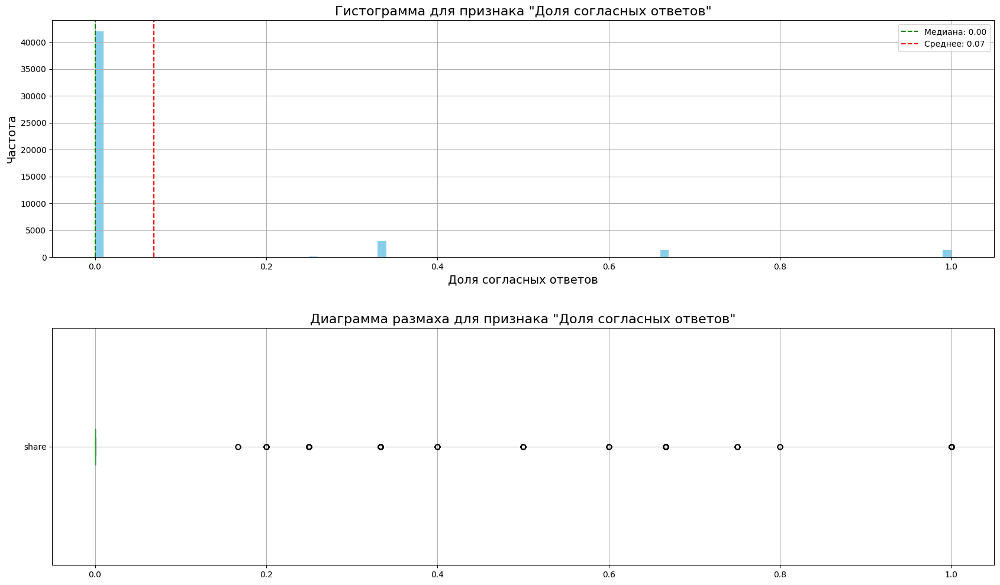

In [ ]:
analyze_numerical_data(crowd_annotations, 'share', 'Доля согласных ответов')

In [ ]:
merged = train_dataset.merge(
        crowd_annotations,
        how='inner',
        on=['image', 'query_id'])

merged['share'].mean()

np.float64(0.19828252468870758)

Средняя доля случаев соответствия изображениям описаний ниже вычисленной нами ранее(0.027).

Датасет `crowd_annotations` содержит 47830 записей, типы данных определены верно, названия столбцов записаны в змеиной нотации, пропусков и дубликатов нет. Нет данных по 3493 строкам из тренировочного датасета (из 5822). Максимальное число подтвердивших соответствие - 5, несоответствие - 6. Чаще всего описание оценивали 3 человека. Большинство не подтверждает соответствие изображения описанию.

### ExpertAnnotations.tsv

In [ ]:
expert_annotations = pd.read_csv(FILES_PATH + 'ExpertAnnotations.tsv',
                                 sep='\t', header=None,
                                 names=['image', 'query_id', 'grade_1',
                                        'grade_2', 'grade_3'])
expert_annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   grade_1   5822 non-null   int64 
 3   grade_2   5822 non-null   int64 
 4   grade_3   5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


In [ ]:
expert_annotations.head()

,image,query_id,grade_1,grade_2,grade_3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2


In [ ]:
expert_annotations.duplicated().sum()

np.int64(0)

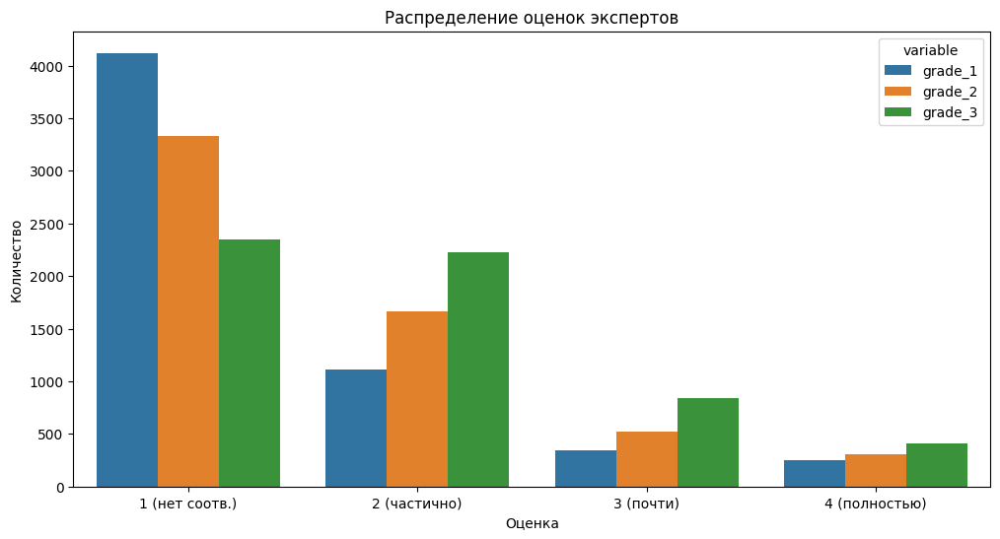

In [ ]:
plt.figure(figsize=(12, 6))
sns.countplot(
    data=pd.melt(expert_annotations[['grade_1', 'grade_2', 'grade_3']]),
    x='value', hue='variable')
plt.title('Распределение оценок экспертов')
plt.xlabel('Оценка')
plt.ylabel('Количество')
plt.xticks([0,1,2,3],
           ['1 (нет соотв.)', '2 (частично)', '3 (почти)', '4 (полностью)'])
plt.show()

In [ ]:
check_complete_match(train_dataset, expert_annotations)

Все строки присутствуют


In [ ]:
print("Случаи полного согласия:",
      (expert_annotations[['grade_1', 'grade_2', 'grade_3']]
       .nunique(axis=1) == 1).sum())

Случаи полного согласия: 3391


In [ ]:
print("Случаи полного несогласия:",
      (expert_annotations[['grade_1', 'grade_2', 'grade_3']]
       .nunique(axis=1) == 3).sum())

Случаи полного несогласия: 126


Датасет с оценками экспертов содержит 5822 записи, пропусков и дубликатов нет. Имеются оценки для всех пар "изображение-описание" из тренировочного датасета, в 3391 случае наблюдается полное согласие экспертов в оценке. В 126 случаях нет ни одного совпадающего мнения.

### Использование оценок на соответсвие изображения описанию

 Т.к. оценки, полученные с помощью краудсорсинга, и оценки экспертов выставлялись по разной шкале (в первом случае - только соотвествие/несоотвествие, для экспертов шкала шире), а также с учетом того факта, что более чем для половины тренировочного датасета оценки на краудсорсинге отсутствуют, а оценки эскпертов есть для всех записей, в работе будем использовать только оценки экспертов. Случаи полного несовпадения оценок экспертов учитывать не будем, для оставшихся записей возьмем моду и так выведем общую оценку.

In [ ]:
train_df_with_grade = train_dataset.merge(
    expert_annotations,
    how='left',
    on=['image', 'query_id']
)

train_df_with_grade.shape

(5822, 6)

In [ ]:
mask = (train_df_with_grade[['grade_1', 'grade_2', 'grade_3']]
        .nunique(axis=1) == 3)
train_df_with_grade = train_df_with_grade[~mask]

train_df_with_grade.shape

(5696, 6)

In [ ]:
train_df_with_grade['grade'] = (
    train_df_with_grade[['grade_1', 'grade_2', 'grade_3']].mode(axis=1))
train_df_with_grade.head()

,image,query_id,query_text,grade_1,grade_2,grade_3,grade
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1,1,1,1
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1,1,1,1
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1,2,2,2
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,4,4,4,4
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1,1,1,1


In [ ]:
train_df_with_grade = train_df_with_grade.drop(
    columns=['grade_1', 'grade_2', 'grade_3'])
train_df_with_grade.head()

,image,query_id,query_text,grade
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,2
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,4
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1


Модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1. Т.е. нам необходимо нормализовать признак `grade`.

Выполним линейное перобразование X_norm = (X - X_min) / (X_max− X_min). Минимальная оценка экспертов - 1, максимальная - 4.

In [ ]:
train_df_with_grade['scaled_grade'] = (train_df_with_grade['grade'] - 1) / 3

train_df_with_grade.sample(5)

,image,query_id,query_text,grade,scaled_grade
3334,3506468593_7e41a6d9f1.jpg,448252603_7d928c900e.jpg#2,A man points his finger to the path ahead as h...,1,0.0
1075,2458269558_277012780d.jpg,2526041608_a9775ab8d7.jpg#2,The young football player is trying to avoid b...,1,0.0
1891,2197275664_fabcf3424b.jpg,3301811927_a2797339e5.jpg#2,Hockey players with one taking a shot .,1,0.0
1320,1432179046_8e3d75cf81.jpg,2183227136_8bb657846b.jpg#2,A person on the beach beside the ocean at suns...,1,0.0
2646,2587818583_4aa8e7b174.jpg,263854883_0f320c1562.jpg#2,Two small dogs run through the grass .,1,0.0


In [ ]:
train_df_with_grade = train_df_with_grade.drop(columns=['grade'])

__Промежуточный вывод__:
- загрузили все данные, данные соответсвуют описанию;
- в тренировочном датасете всего 2.7% записей, где изображение соответсвует описанию (исходя из формата записи), в тестовом - 100%;
- данные требуют очистки (присутствуют фото детей);
- изучили файлы с оценками соответсвия изображений описанию, в дальнейшем будем использовать только экспертные оценки, т.к. шкала таких оценок шире и они полностью покрывают тренировочный датасет;
- дополнили тренировочный датасет обобщенной оценкой экспертов, случаи, когда все эксперты выставляли разные оценки, удалили. Нормализовали значение агрегированной оценки. После изменений тренировочный датасет содержит 5696 записей.

## Подготовка данных к обучению модели

### Юридические ограничения

Для учета запрета на использование изображений детей, мы будем использовать список слов, которые не должны встречаться в описании.

In [ ]:
FORBIDDEN_WORDS

['child',
 'kid',
 'infant',
 'newborn',
 'toddler',
 'baby',
 'juvenile',
 'adolescent',
 'teen',
 'teenager',
 'girl',
 'boy']

Воспользуемся этим списком после очистки и лемматизации текста.

> Опытным путем проверили, что такой способ позволяет найти больше запрещенных материалов, чем использование расширенного словаря (со словами во множественном числе) и поиск по `re.findall(r'\b\w+\b', row['query_text'].lower())`.

In [ ]:
def clear_text(text):

    text = contractions.fix(text)
    text = text.lower()
    pattern = r"[^a-z'\s]"
    t = re.sub(pattern, ' ', text)
    return ' '.join(t.split())

In [ ]:
def penn2morphy(penntag):
    """ Converts Penn Treebank tags to WordNet. """
    morphy_tag = {'NN':'n', 'JJ':'a',
                  'VB':'v', 'RB':'r'}
    try:
        return morphy_tag[penntag[:2]]
    except:
        return 'n'

In [ ]:
def lemmatize_text(text, lemmatizer):

    tokens = word_tokenize(str(text))
    tagged = pos_tag(tokens)
    lemmatized = [lemmatizer.lemmatize(word, pos=penn2morphy(tag)) for word, tag in tagged]
    return ' '.join(lemmatized)

In [ ]:
lemmatizer = WordNetLemmatizer()

train_df_with_grade['prepared_text'] = train_df_with_grade['query_text'].apply(clear_text)
train_df_with_grade['prepared_text'] = train_df_with_grade['prepared_text'].progress_apply(
    lambda x: lemmatize_text(x, lemmatizer=lemmatizer))

train_df_with_grade[['query_text', 'prepared_text']].sample(5)

  0%|          | 0/5696 [00:00<?, ?it/s]

,query_text,prepared_text
3212,A white dog is walking through a river that ru...,a white dog be walk through a river that run t...
2554,Two people sit on a large rock near a city str...,two people sit on a large rock near a city street
3523,"Crowded Mexican restaurant , empty chair in fo...",crowd mexican restaurant empty chair in foregr...
696,Two puppies are playing in the leaves .,two puppy be play in the leaf
2371,A white dog is chasing a stuffed animal being ...,a white dog be chase a stuffed animal be pull ...


Теперь определим, какие файлы содержат изображения детей. Для этого будем искать запрещенные слова в описаниях изображений, а имена файлов возьмем из идентификатора описания.

In [ ]:
def check_query_text(data, forbidden_words):
    """
    Проверяет наличие запрещенных слов в тексте запроса и возвращает:
    - множество имен файлов, описание которых содержит запрещенные слова
    - список id строк, содержащих запрещенные слова

    Параметры:
    - data: DataFrame, должен содержать колонки 'prepared_text' и 'query_id'
    - forbidden_words: список запрещенных слов для проверки

    Возвращает:
    - кортеж из множества имен файлов и списка id
    """
    forbidden_files = set()
    ids_forbidden_queries = []

    for index, row in data.iterrows():
        for word in forbidden_words:
            if word in row['prepared_text'].split():
                forbidden_files.add(row['query_id'].split('#')[0])
                ids_forbidden_queries.append(index)
                break

    return forbidden_files, ids_forbidden_queries

In [ ]:
forbidden_files, ids_forbidden_queries = check_query_text(
    train_df_with_grade, FORBIDDEN_WORDS)
print(f"{len(ids_forbidden_queries)} строк содержат запрещенные слова.")
print(f"{len(forbidden_files)} файлов содержат запрещенные изображения.")
count = train_df_with_grade['image'].isin(forbidden_files).sum()
print(f"Количество записей с запрещенными файлами: {count}")

1521 строк содержат запрещенные слова.
289 файлов содержат запрещенные изображения.
Количество записей с запрещенными файлами: 1688


In [ ]:
train_df_with_grade = train_df_with_grade.drop(ids_forbidden_queries)
train_df_with_grade = train_df_with_grade[~train_df_with_grade['image'].isin(forbidden_files)]
train_df_with_grade.shape

(3114, 5)

### Векторизация изображений

Перейдём к векторизации изображений.
Прочесть изображение и превратить полученную матрицу в вектор нам не подходит: длина векторов может быть сильно разной, так как размеры изображений разные.

Будем использовать сверточную сеть, модель архитектуры ResNet-18, предварительно натренированную на датасете ImageNet. Обучение отключим.

In [ ]:
resnet = models.resnet18(pretrained=True)

for param in resnet.parameters():
    param.requires_grad_(False)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 177MB/s]


Для получения эмбеддингов не будем использовать последний слой (_если не брать 2 последних, получается слишком большая размерность - 25088_).

In [ ]:
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules)

In [ ]:
def vectorize_images(data, path, model):
    """
    Векторизация изображений с помощью предобученной модели
    с предварительной обработкой изображений (изменение размера,
     вырезание центра и нормализация).

    Args:
        data: DataFrame с колонкой 'image' (имена файлов)
        path: путь к папке с изображениями
        model: предобученная модель

    Returns:
        numpy.ndarray с векторными представлениями изображений
    """
    embeddings = []

    norm = transforms.Normalize(
        mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    preprocess = transforms.Compose(
        [transforms.Resize(256),
         transforms.CenterCrop(224),
         transforms.ToTensor(),
         norm,
         ])

    model.eval() # переводим в режим предсказания

    for _, row in tqdm(data.iterrows(), total=len(data)):
        full_path_img = os.path.join(path, row['image'])
        if os.path.exists(full_path_img):
            img = Image.open(full_path_img).convert('RGB')
        else:
            print(f'Image {full_path_img} not found')
            return

        image_tensor = preprocess(img)
        output_tensor = model(image_tensor.unsqueeze(0)).flatten()
        embeddings.append(output_tensor)

    return np.vstack(embeddings)

In [ ]:
vectorized_train_images = vectorize_images(train_df_with_grade,
                                           TRAIN_IMAGES_PATH, resnet)
print(f"Размерность векторов для изображений: {vectorized_train_images.shape}")

  0%|          | 0/3114 [00:00<?, ?it/s]

Размерность векторов для изображений: (3114, 512)


### Векторизация текста

In [ ]:
def vectorize_text_with_bert_base_uncased(data, batch_size):
    """
    Векторизует список текстов с помощью BERT, возвращает эмбеддинги

    Параметры:
        data (Series): Столбец с текстом
        batch_size (int): Размер батча для обработки

    Возвращает:
        np.ndarray: Массив эмбеддингов формы (n_samples, hidden_size)
    """
    # Инициализация модели и токенизатора
    tokenizer = transformers.BertTokenizer.from_pretrained('bert-base-uncased')
    model = transformers.BertModel.from_pretrained('bert-base-uncased')
    model.eval()

    # Определяем, нужно ли показывать прогресс-бар
    show_progress = len(data) > 1

    # Токенизация, паддинг
    tokenized = [tokenizer.encode(query, add_special_tokens=True,
                     max_length=510, truncation=True)
                    for query in tqdm(data,
                                    desc="Токенизация текстов",
                                    disable=not show_progress)]
    max_length = max(len(vector) for vector in tokenized)
    padded = [vector + [0] * (max_length - len(vector))
                 for vector in tqdm(tokenized,
                                  desc="Добавление паддинга",
                                  disable=not show_progress)]

    padded = np.array(padded)
    attention_mask = np.where(np.array(padded) != 0, 1, 0)

    # Преобразование в тензоры
    input_ids = torch.LongTensor(padded)
    attention_mask = torch.LongTensor(attention_mask)

    # Вычисление эмбеддингов батчами
    embeddings = []
    for i in tqdm(range(0, len(input_ids), batch_size),
                  desc="Извлечение эмбеддингов",
                  disable=not show_progress):
        batch_ids = input_ids[i:i+batch_size]
        batch_mask = attention_mask[i:i+batch_size]

        with torch.no_grad():
            batch_embeddings = model(batch_ids, attention_mask=batch_mask)

        embeddings.append(batch_embeddings[0][:,0,:].numpy())

    return np.concatenate(embeddings)

In [ ]:
def vectorize_text(data, batch_size=32):
    """
    Векторизует список текстов с помощью sentence-transformers,
    возвращает эмбеддинги.

    Параметры:
        data (list or pd.Series): Список или Series с текстами
        batch_size (int): Размер батча для обработки

    Возвращает:
        np.ndarray: Массив эмбеддингов формы (n_samples, hidden_size)
    """
    # Загрузка модели
    model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

    if isinstance(data, str):
        data = [data]
    if hasattr(data, 'tolist'):
        data = data.tolist()

    show_progress = len(data) > 1

    # Преобразование текстов в эмбеддинги
    embeddings = []
    for i in tqdm(range(0, len(data), batch_size),
                 desc="Извлечение эмбеддингов",
                 disable=not show_progress):
        batch = data[i:i+batch_size]
        batch_embeddings = model.encode(batch,
                                      convert_to_numpy=True,
                                      show_progress_bar=False)
        embeddings.append(batch_embeddings)

    return np.concatenate(embeddings)

 Векторизируем тексты, используя модель `all-MiniLM-L6-v2`.

In [ ]:
train_text_features = vectorize_text(train_df_with_grade['query_text'],
                                     batch_size=64)
print(f"Размерность векторов для текста: {train_text_features.shape}")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Извлечение эмбеддингов:   0%|          | 0/49 [00:00<?, ?it/s]

Размерность векторов для текста: (3114, 384)


Итоговая размерность для тренировочных данных: для текстов - (3114, 384), что соответсвует количеству строк в исходном датасете и размерности вектора при использовании all-MiniLM-L6-v2(384), для изображений: (3114, 512), что соответсвует количеству строк в исходном датасете и  количеству каналов в последнем слое перед полносвязной частью.

### Объединение векторов

Объединим векторы изображений и векторы текстов с целевой переменной (агрегированной оценкой экспертов).

In [ ]:
train_data = pd.concat([
    train_df_with_grade[['scaled_grade']].reset_index(drop=True),
    pd.DataFrame(vectorized_train_images).reset_index(drop=True),
    pd.DataFrame(train_text_features).reset_index(drop=True)],
    axis=1)
train_data.shape

(3114, 897)

In [ ]:
train_data.head()

,scaled_grade,0,1,2,3,4,5,6,7,8,...,374,375,376,377,378,379,380,381,382,383
0,0.000000,0.693940,3.031836,2.916934,0.951898,0.936295,1.245116,0.826524,1.107943,0.169679,...,-0.024695,-0.061539,-0.070751,0.012658,-0.049589,-0.00212,-0.066631,-0.057848,-0.101642,0.043559
1,0.333333,0.271913,2.482275,1.619974,1.238905,1.795557,0.700188,0.333722,0.682629,0.458916,...,-0.024695,-0.061539,-0.070751,0.012658,-0.049589,-0.00212,-0.066631,-0.057848,-0.101642,0.043559
2,0.333333,0.980700,3.829267,1.296653,0.803809,0.516702,0.409123,0.724030,0.838804,0.244275,...,-0.024695,-0.061539,-0.070751,0.012658,-0.049589,-0.00212,-0.066631,-0.057848,-0.101642,0.043559
3,0.333333,1.519509,1.070954,0.178771,0.297532,0.567791,0.143536,1.374603,0.297598,0.276965,...,-0.024695,-0.061539,-0.070751,0.012658,-0.049589,-0.00212,-0.066631,-0.057848,-0.101642,0.043559
4,0.000000,0.341053,3.860156,1.173057,0.526687,0.542607,0.759330,0.779954,0.009413,0.828654,...,-0.024695,-0.061539,-0.070751,0.012658,-0.049589,-0.00212,-0.066631,-0.057848,-0.101642,0.043559


__Промежуточный вывод__:
- мы очистили тренировочные данные изображений и описсаний, где изображены/упоминаются дети, после очистки осталось 3114 записей;
-  выполнили векторизацию изображений и описаний к ним, объединили полученные векторные представления с целевой переменной, размер полученного датасета - (3114, 897).

## Обучение модели предсказания соответствия

Для обучения разделим датасет на тренировочную и валидационную выборки. Простое случайное разбиение не подходит: нужно исключить попадание изображения и в обучающую, и в валидационную выборки.
Для того чтобы учесть изображения при разбиении, воспользуемя классом GroupShuffleSplit из библиотеки sklearn.model_selection.

In [ ]:
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=RANDOM_STATE)
train_indices, test_indices = next(gss.split(
    X=train_df_with_grade.drop(columns=['scaled_grade']),
    y=train_df_with_grade['scaled_grade'],
    groups=train_df_with_grade['image']))

train_df, val_df = train_data.loc[train_indices], train_data.loc[test_indices]
train_df.shape, val_df.shape

((2163, 897), (951, 897))

In [ ]:
X_train = train_df.drop(columns=['scaled_grade'])
y_train = train_df['scaled_grade']
X_valid = val_df.drop(columns=['scaled_grade'])
y_valid = val_df['scaled_grade']

Учитывая, что наши входные данные - это объединение векторов изображений и текстов, далее протестируем подход с масштабированием данных и без него.

In [ ]:
# масштабируем данные
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

Модель должна возвращать на выходе вероятность соответствия изображения тексту, в качестве метрики выберем RMSE.


In [ ]:
def get_rmse(model, X_valid, y_valid):
    """
    Вычисляет RMSE модели на валидационных данных.

    Args:
        model (object): Обученная модель.
        X_valid (DataFrame): Валидационные признаки.
        y_valid (DataFrame): Валидационные целевые значения.

    Returns:
        float: RMSE модели.
    """
    predictions = model.predict(X_valid)
    rmse = np.sqrt(mean_squared_error(y_valid, predictions))
    return rmse

### LinearRegression

In [ ]:
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
linear_model_rmse = get_rmse(linear_model, X_valid, y_valid)
print(f"RMSE LinearRegression: {linear_model_rmse}")

RMSE LinearRegression: 1.0859823419751096


In [ ]:
scaled_linear_model = LinearRegression()
scaled_linear_model.fit(X_train_scaled, y_train)
scaled_linear_model_rmse = get_rmse(scaled_linear_model, X_valid_scaled, y_valid)
print(f"RMSE ScaledLinearRegression: {scaled_linear_model_rmse}")

RMSE ScaledLinearRegression: 1.0756792455142237


Средняя ошибка предсказания модели больше, чем макимальный дипазон  значений вероятности (1). Модель бесполезна как при масштабировании признаков, так и без масштабирования. Результат ее работы будет хуже, чем случайное угадывание.

### Ridge

In [ ]:
ridge = Ridge()
param_grid = {'alpha': np.logspace(-4, 4, 50)}
grid_search_ridge = GridSearchCV(
    ridge, param_grid, cv=5, scoring='neg_root_mean_squared_error')
grid_search_ridge.fit(X_train, y_train)

best_ridge = grid_search_ridge.best_estimator_
ridge_rmse = get_rmse(best_ridge, X_valid, y_valid)

print(f"Лучшая модель: {best_ridge}")
print(f"RMSE Ridge: {ridge_rmse}")

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=2.3405e-11): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=2.1533e-11): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=9.4635e-11): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=1.00306e-10): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: 

Лучшая модель: Ridge(alpha=np.float64(3237.45754281764))
RMSE Ridge: 0.29911272570920744


In [ ]:
scaled_ridge = Ridge()
param_grid = {'alpha': np.logspace(-4, 4, 50)}
grid_search_ridge = GridSearchCV(
    scaled_ridge, param_grid, cv=5, scoring='neg_root_mean_squared_error')
grid_search_ridge.fit(X_train_scaled, y_train)

best_ridge = grid_search_ridge.best_estimator_
scaled_ridge_rmse = get_rmse(best_ridge, X_valid_scaled, y_valid)

print(f"Лучшая модель: {best_ridge}")
print(f"RMSE Ridge: {scaled_ridge_rmse}")

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=2.0396e-11): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=2.13824e-10): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=3.98408e-10): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning: Ill-conditioned matrix (rcond=6.37896e-10): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_ridge.py:215: LinAlgWarning

Лучшая модель: Ridge(alpha=np.float64(6866.488450042998))
RMSE Ridge: 0.29290227549589315


### Полносвязные нейронные сети

In [ ]:
def train_model(net, X_train, y_train, X_test, y_test,
                learning_rate=0.001, num_epochs=100000, batch_size=64, printing=True, patience=5):
    """
    Обучает нейронную сеть net на обучающих данных X_train и y_train,
    используя оптимизатор Adam с learning_rate, реализовано раннее прерывание обучения.
    Перед завершением работы восстанавливается состояние модели,
    достигшей наилучшей производительности.

    Параметры:
        net (nn.Module): Нейронная сеть для обучения.
        X_train (torch.Tensor): Тензор входных данных для обучения.
        y_train (torch.Tensor): Тензор выходных данных для обучения.
        X_test (torch.Tensor): Тензор входных данных для тестирования.
        y_test (torch.Tensor): Тензор выходных данных для тестирования.
        learning_rate (float): Скорость обучения для оптимизатора (по умолчанию 0.001).
        num_epochs (int): Количество эпох обучения (по умолчанию 100000).
        batch_size (int): Размер батча для обучения (по умолчанию 64).
        printing (bool): Флаг для вывода информации об обучении (по умолчанию True).
        patience (int): Количество эпох без улучшения для ранней остановки (по умолчанию 5).

    Возвращает:
        train_loss_values (list): Список значений потерь на обучающем наборе.
        test_loss_values (list): Список значений потерь на тестовом наборе.
        epoch_count (list): Список номеров эпох.
        best_test_loss (float): Лучшее значение метрики на тестовой выборке.
    """

    # переменные для ранней остановки
    best_test_loss = float('inf')
    epochs_without_improvement = 0

    optimizer = torch.optim.Adam(net.parameters(), lr=learning_rate)
    loss = nn.MSELoss()
    num_batches = ceil(len(X_train) / batch_size)

    # результаты обучения
    train_loss_values = []
    test_loss_values = []
    epoch_count = []
    best_model_state = None

    for epoch in range(num_epochs):
        net.train()
        order = np.random.permutation(len(X_train))

        for batch_idx in range(num_batches):
            start_index = batch_idx * batch_size
            optimizer.zero_grad()

            # Получение индексов текущего батча
            batch_indexes = order[start_index:start_index + batch_size]
            X_batch = X_train[batch_indexes]
            y_batch = y_train[batch_indexes]

            preds = net.forward(X_batch).flatten()
            loss_value = loss(preds, y_batch)
            loss_value.backward()
            optimizer.step()

        if epoch % 10 == 0 or epoch == num_epochs - 1:
            net.eval()
            with torch.no_grad():
                test_preds = net.forward(X_test).flatten()
                mse = loss(test_preds, y_test)
                test_rmse = torch.sqrt(mse)
                train_rmse = torch.sqrt(loss_value)

            if printing:
                print(f"Epoch: {epoch:3d} | RMSE Train Loss: {train_rmse:.5f} | "
                      f"RMSE Test Loss: {test_rmse:.5f}")
            epoch_count.append(epoch)
            test_loss_values.append(test_rmse.detach().numpy())
            train_loss_values.append(train_rmse.detach().numpy())

            # Ранняя остановка
            if test_rmse < best_test_loss:
                best_test_loss = test_rmse
                epochs_without_improvement = 0
                best_model_state = net.state_dict()
            else:
                epochs_without_improvement += 1

            if epochs_without_improvement >= patience:
                if printing:
                    print(f"Early stopping at epoch {epoch}. "
                          f"Best test loss: {best_test_loss:.5f}")
                break

    net.load_state_dict(best_model_state)
    return train_loss_values, test_loss_values, epoch_count, best_test_loss

In [ ]:
def plot_loss(train_loss_values, test_loss_values, epoch_count):
    """
    Строит график потерь на обучающем и тестовом наборе данных по эпохам.

    Параметры:
        train_loss_values : Список значений потерь на обучающем наборе по эпохам.
        test_loss_values : Список значений потерь на тестовом наборе по эпохам.
        epoch_count: Список номеров эпох.

    Результат:
        Визуализация графика потерь на обучающем и тестовом наборе данных.
    """

    plt.figure(figsize=(9, 6))

    plt.title("Train / test loss")
    plt.xlabel("$Epoch$")
    plt.ylabel("$Loss$")

    plt.plot(epoch_count, train_loss_values)
    plt.plot(epoch_count, test_loss_values)

    plt.legend(["Train", "Test"])
    plt.show()

In [ ]:
n_in_neurons = X_train.shape[1]
n_out_neurons = 1

X_train_ft = torch.FloatTensor(np.array(X_train))
y_train_ft = torch.FloatTensor(np.array(y_train))
X_valid_ft = torch.FloatTensor(np.array(X_valid))
y_valid_ft = torch.FloatTensor(np.array(y_valid))

X_train_scaled_ft = torch.FloatTensor(np.array(X_train_scaled))
X_valid_scaled_ft = torch.FloatTensor(np.array(X_valid_scaled))

Epoch:   0 | RMSE Train Loss: 0.38033 | RMSE Test Loss: 0.37197
Epoch:  10 | RMSE Train Loss: 0.28065 | RMSE Test Loss: 0.34316
Epoch:  20 | RMSE Train Loss: 0.26856 | RMSE Test Loss: 0.32829
Epoch:  30 | RMSE Train Loss: 0.30621 | RMSE Test Loss: 0.31689
Epoch:  40 | RMSE Train Loss: 0.31787 | RMSE Test Loss: 0.31278
Epoch:  50 | RMSE Train Loss: 0.27833 | RMSE Test Loss: 0.31137
Epoch:  60 | RMSE Train Loss: 0.25398 | RMSE Test Loss: 0.30751
Epoch:  70 | RMSE Train Loss: 0.25462 | RMSE Test Loss: 0.30934
Epoch:  80 | RMSE Train Loss: 0.30051 | RMSE Test Loss: 0.30765
Epoch:  90 | RMSE Train Loss: 0.23483 | RMSE Test Loss: 0.30722
Epoch: 100 | RMSE Train Loss: 0.20275 | RMSE Test Loss: 0.30637
Epoch: 110 | RMSE Train Loss: 0.25067 | RMSE Test Loss: 0.30750
Epoch: 120 | RMSE Train Loss: 0.24251 | RMSE Test Loss: 0.30621
Epoch: 130 | RMSE Train Loss: 0.25301 | RMSE Test Loss: 0.30672
Epoch: 140 | RMSE Train Loss: 0.21350 | RMSE Test Loss: 0.30739
Epoch: 150 | RMSE Train Loss: 0.22995 | 

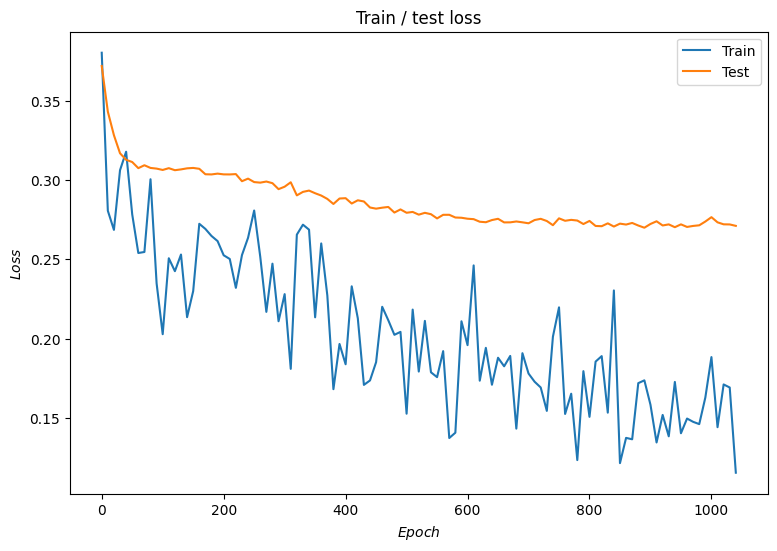

In [ ]:
net = nn.Sequential(
    nn.Linear(n_in_neurons, 1024),
    nn.BatchNorm1d(1024),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(1024, 512),
    nn.BatchNorm1d(512),
    nn.LeakyReLU(),
    nn.Dropout(0.4),

    nn.Linear(512, 256),
    nn.BatchNorm1d(256),
    nn.LeakyReLU(),
    nn.Dropout(0.2),

    nn.Linear(256, 1),
    nn.Sigmoid()
)

train_loss_values, valid_loss_values, epoch_count, net_best_valid_rmse = train_model(
    net, X_train_ft, y_train_ft, X_valid_ft, y_valid_ft,
    learning_rate=0.00001, batch_size=64, patience=15)
plot_loss(train_loss_values, valid_loss_values, epoch_count)

In [ ]:
net_rmse = net_best_valid_rmse.item()

Epoch:   0 | RMSE Train Loss: 0.41281 | RMSE Test Loss: 0.37886
Epoch:  10 | RMSE Train Loss: 0.30445 | RMSE Test Loss: 0.34343
Epoch:  20 | RMSE Train Loss: 0.31034 | RMSE Test Loss: 0.32051
Epoch:  30 | RMSE Train Loss: 0.25908 | RMSE Test Loss: 0.30472
Epoch:  40 | RMSE Train Loss: 0.27293 | RMSE Test Loss: 0.29475
Epoch:  50 | RMSE Train Loss: 0.28320 | RMSE Test Loss: 0.28603
Epoch:  60 | RMSE Train Loss: 0.28995 | RMSE Test Loss: 0.27894
Epoch:  70 | RMSE Train Loss: 0.24355 | RMSE Test Loss: 0.27264
Epoch:  80 | RMSE Train Loss: 0.22012 | RMSE Test Loss: 0.26921
Epoch:  90 | RMSE Train Loss: 0.21082 | RMSE Test Loss: 0.27114
Epoch: 100 | RMSE Train Loss: 0.17774 | RMSE Test Loss: 0.26411
Epoch: 110 | RMSE Train Loss: 0.20804 | RMSE Test Loss: 0.26982
Epoch: 120 | RMSE Train Loss: 0.17240 | RMSE Test Loss: 0.26683
Epoch: 130 | RMSE Train Loss: 0.16001 | RMSE Test Loss: 0.26225
Epoch: 140 | RMSE Train Loss: 0.14265 | RMSE Test Loss: 0.26297
Epoch: 150 | RMSE Train Loss: 0.16531 | 

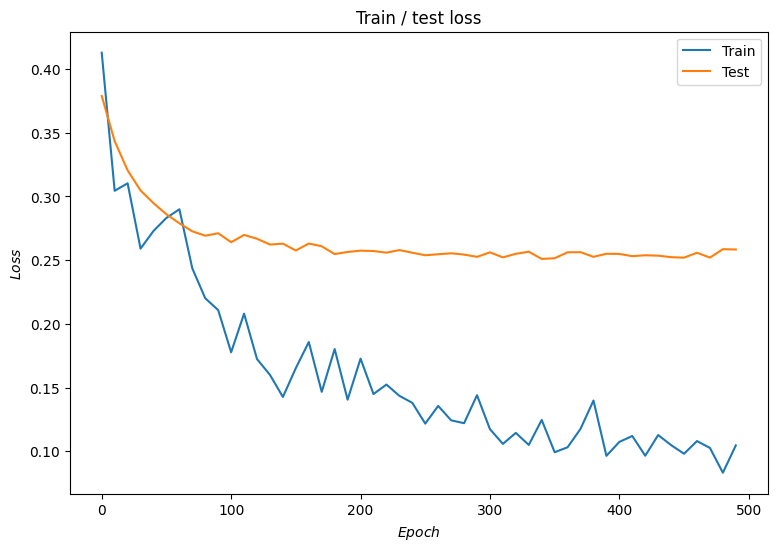

In [ ]:
net_scaled = nn.Sequential(
    nn.Linear(n_in_neurons, 1024),
    nn.BatchNorm1d(1024),
    nn.ReLU(),
    nn.Dropout(0.5),

    nn.Linear(1024, 512),
    nn.BatchNorm1d(512),
    nn.LeakyReLU(),
    nn.Dropout(0.4),

    nn.Linear(512, 256),
    nn.BatchNorm1d(256),
    nn.LeakyReLU(),
    nn.Dropout(0.2),

    nn.Linear(256, 1),
    nn.Sigmoid()
)

train_loss_values, valid_loss_values, epoch_count, net_best_valid_rmse = train_model(
    net_scaled, X_train_scaled_ft, y_train_ft, X_valid_scaled_ft, y_valid_ft,
    learning_rate=0.00001, batch_size=64, patience=15)
plot_loss(train_loss_values, valid_loss_values, epoch_count)

In [ ]:
scaled_net_rmse = net_best_valid_rmse.item()

### DummyRegressor

In [ ]:
dummy_model = DummyRegressor()
dummy_model.fit(X_train, y_train)
dummy_rmse = get_rmse(dummy_model, X_valid, y_valid)
dummy_rmse

np.float64(0.3126910668456728)

### Сравнение моделей

In [ ]:
rez = pd.DataFrame(
    {
        "model": ["LinearRegression", "Ridge", "Net", "Dummy",
                  "LinearRegression(scaled)", "Ridge(scaled)", "Net(scaled)",],
        "RMSE": [linear_model_rmse, ridge_rmse, net_rmse, dummy_rmse,
                        scaled_linear_model_rmse, scaled_ridge_rmse, scaled_net_rmse]
    }
)
rez.sort_values(by='RMSE')

,model,RMSE
6,Net(scaled),0.250977
2,Net,0.269933
5,Ridge(scaled),0.292902
1,Ridge,0.299113
3,Dummy,0.312691
4,LinearRegression(scaled),1.075679
0,LinearRegression,1.085982


__Промежуточный вывод__:
- мы обучили несколько моделей (LinearRegression, Ridge, нейронную сеть и DummyRegressor) на масштабированных и немасштабированных данных;
- линейная регрессия показала результат хуже, чем dummy модель,
- лучший результат на валидационной выборке показала полносвязная нейронная сеть, обученная на масштабированных тренировочных данных.

## Тестирование модели

Получим эмбеддинги для всех тестовых изображений из папки test_images.

In [ ]:
test_images = test_queries['image'].drop_duplicates().reset_index(drop=True).to_frame()
test_images.shape

(100, 1)

In [ ]:
test_images.head()

,image
0,1177994172_10d143cb8d.jpg
1,1232148178_4f45cc3284.jpg
2,123997871_6a9ca987b1.jpg
3,1319634306_816f21677f.jpg
4,1429546659_44cb09cbe2.jpg


In [ ]:
vectorized_test_images = vectorize_images(test_images, TEST_IMAGES_PATH, resnet)
print(f"Размерность векторов для изображений(тестовые данные): {vectorized_test_images.shape}")

  0%|          | 0/100 [00:00<?, ?it/s]

Размерность векторов для изображений(тестовые данные): (100, 512)


Выберем случайные 10 запросов из тестовых данных.

In [ ]:
queries = test_queries['query_text'].sample(10, random_state=RANDOM_STATE)
queries

,query_text
361,A group of girls who are gothically dressed st...
73,A woman and girl riding downhill on a sled wit...
374,The dog is running .
155,A group of people are ice skating in a big city .
104,Little kid in blue coat and hat riding a tricy...
394,Two black dogs fighting over an orange toy .
377,A dog jumping for a tennis ball near an ocean
124,Boy flying a distant kite .
68,kids play ultimate Frisbee .
450,A girl in a purple shirt feeding ducks


Для тестирования модели напишем функцию, которая принимает на вход текстовое описание, делает его векторизацию и возвращает картинку с максимальным значением метрики.

In [ ]:
def get_image(query):

    processed_query = lemmatize_text(clear_text(query), lemmatizer=lemmatizer)
    for word in FORBIDDEN_WORDS:
            if word in processed_query.split():
                print(query)
                print(DISCLAMER)
                return None

    vectorized_query = vectorize_text([query], batch_size=1)
    repeated_query = np.repeat(vectorized_query,
                               vectorized_test_images.shape[0],
                               axis=0)

    X_test = pd.concat([
        pd.DataFrame(vectorized_test_images).reset_index(drop=True),
        pd.DataFrame(repeated_query).reset_index(drop=True)], axis=1)
    X_test = scaler.transform(X_test)
    X_test = torch.FloatTensor(X_test)
    net_scaled.eval()
    predictions = net_scaled.forward(X_test)
    predictions = predictions.detach().numpy()

    merged = pd.concat([test_images, pd.DataFrame(predictions)], axis=1)

    path_of_img = os.path.join(
        TEST_IMAGES_PATH,
        merged.sort_values(by=0, ascending=False).iloc[0]['image'])
    plt.figure()
    img = cv2.cvtColor(cv2.imread(path_of_img), cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title(f"{query}")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

A group of girls who are gothically dressed standing together
This image is unavailable in your country in compliance with local laws.


A woman and girl riding downhill on a sled with a dog running alongside them
This image is unavailable in your country in compliance with local laws.




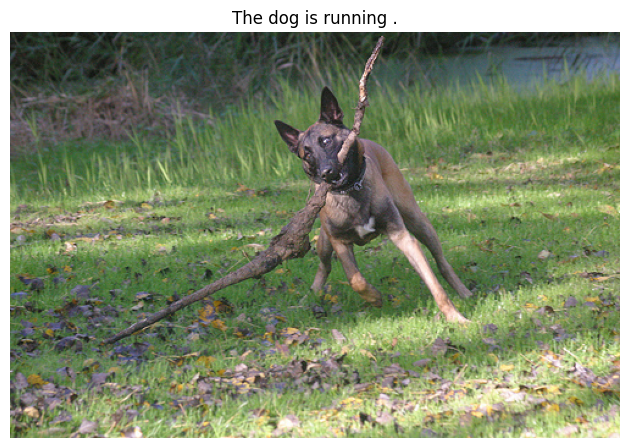

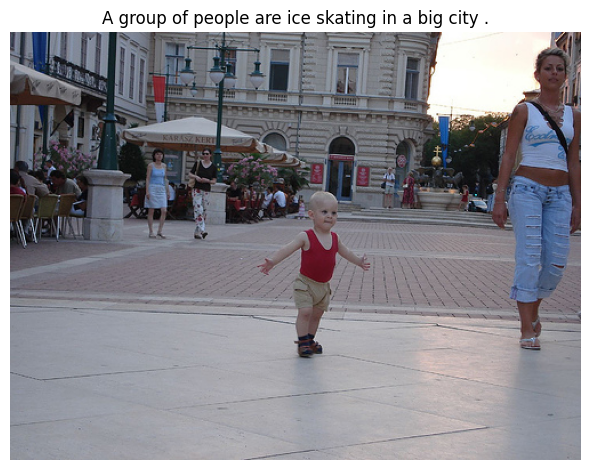



Little kid in blue coat and hat riding a tricycle .
This image is unavailable in your country in compliance with local laws.




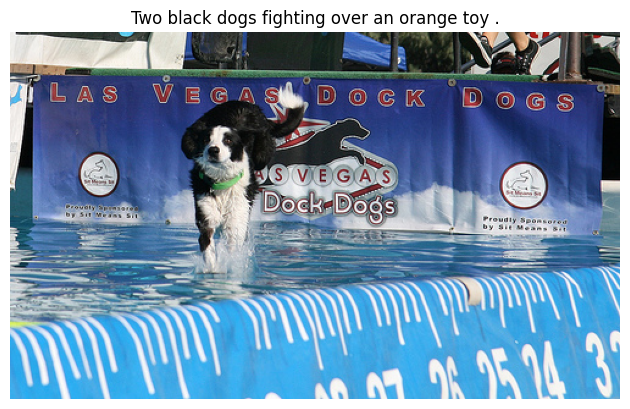

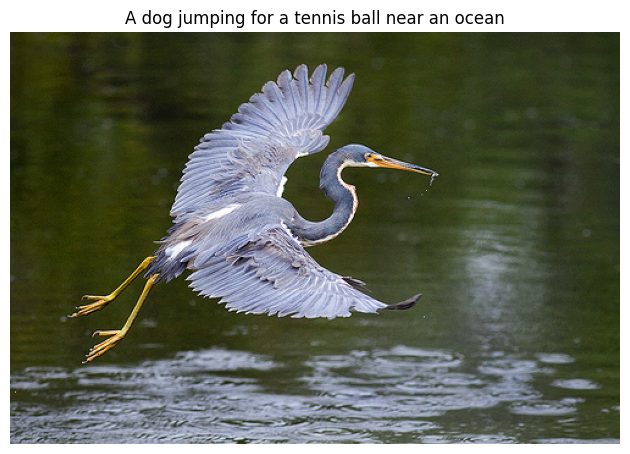



Boy flying a distant kite .
This image is unavailable in your country in compliance with local laws.


kids play ultimate Frisbee .
This image is unavailable in your country in compliance with local laws.


A girl in a purple shirt feeding ducks
This image is unavailable in your country in compliance with local laws.




In [ ]:
for query in queries:
    get_image(query)
    print("\n")

__Промежуточный вывод__:

- Мы блокируем запросы, в которых упоминаются дети. Модель учитывает некоторые слова из запроса, однако нельзя говорить о полном соответствии изображения запросу.

## CLIP

Выполним задачу с использованием нейронной сети CLIP.

In [ ]:
# получаем эмбеддинги тестовых изображений
model = SentenceTransformer("clip-ViT-B-32")

modules.json:   0%|          | 0.00/122 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/1.91k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/604 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/961k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.03k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [ ]:
path_mask = TEST_IMAGES_PATH + "*.jpg"
img_names = list(glob.glob(path_mask))
img_emb = model.encode([Image.open(filepath) for filepath in img_names],
                       batch_size=128,
                       convert_to_tensor=True,
                       show_progress_bar=True)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
def search(query, k=1):
    """
    Функция поиска по изображениям. Выводит дисклеймер в случае
    наличия запрещенных слов.

    Args:
        query (str): Текстовый запрос.
        k (int, optional): Количество результатов поиска. По умолчанию 1.

    Returns:
        None
    """

    processed_query = lemmatize_text(clear_text(query), lemmatizer=lemmatizer)
    for word in FORBIDDEN_WORDS:
            if word in processed_query.split():
                print(query)
                print(DISCLAMER)
                print("\n")
                return None

    # получаем эмбеддинг запроса
    query_emb = model.encode([query], convert_to_tensor=True, show_progress_bar=False)

    # определим k наиболее похожих изображений
    hits = util.semantic_search(query_emb, img_emb, top_k=k)[0]

    print("Query:")
    display(query)
    for hit in hits:
        path_of_img = os.path.join(TEST_IMAGES_PATH,
                                   img_names[hit['corpus_id']])

        plt.figure()
        img = cv2.cvtColor(cv2.imread(path_of_img), cv2.COLOR_BGR2RGB)
        plt.imshow(img)
        plt.title(f"{query}")
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    print("\n")

A group of girls who are gothically dressed standing together
This image is unavailable in your country in compliance with local laws.


A woman and girl riding downhill on a sled with a dog running alongside them
This image is unavailable in your country in compliance with local laws.


Query:


'The dog is running .'

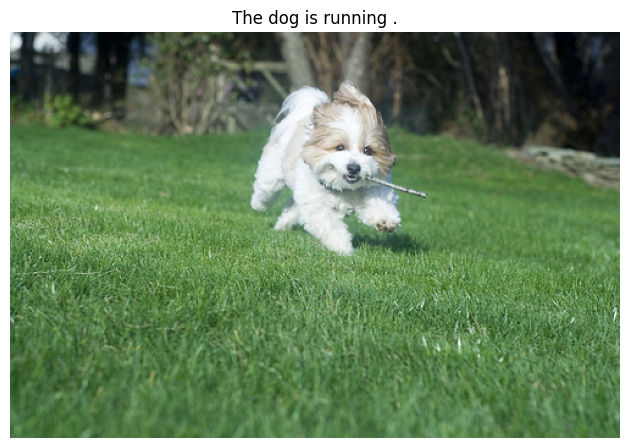



Query:


'A group of people are ice skating in a big city .'

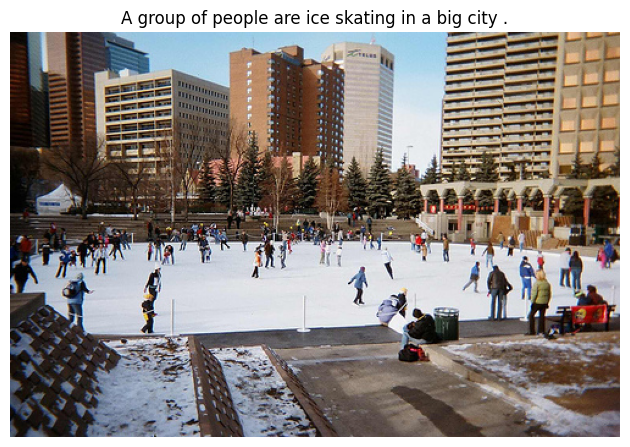



Little kid in blue coat and hat riding a tricycle .
This image is unavailable in your country in compliance with local laws.


Query:


'Two black dogs fighting over an orange toy .'

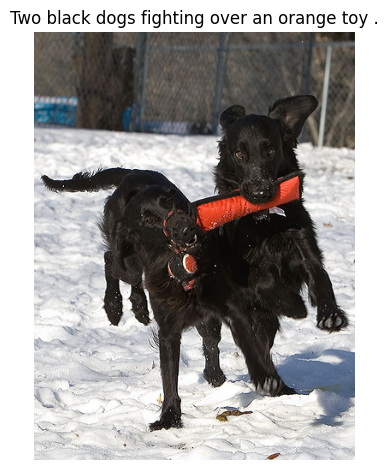



Query:


'A dog jumping for a tennis ball near an ocean'

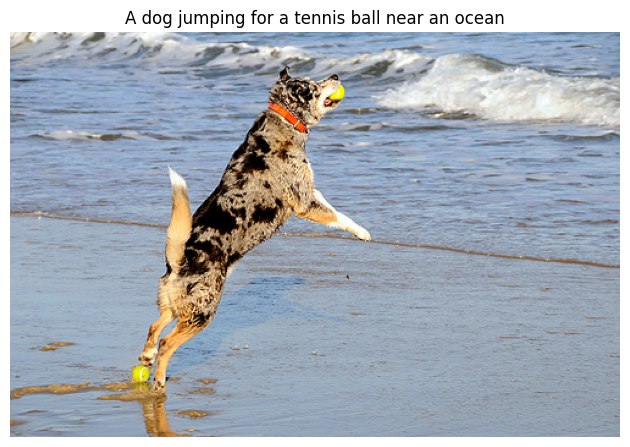



Boy flying a distant kite .
This image is unavailable in your country in compliance with local laws.


kids play ultimate Frisbee .
This image is unavailable in your country in compliance with local laws.


A girl in a purple shirt feeding ducks
This image is unavailable in your country in compliance with local laws.




In [ ]:
for query in queries:
    search(query)

__Промежуточный вывод__:

- отличный результат при использовании нейросети CLIP, все изображения соотвествуют описанию.

## Вывод

Мы разработали демонстрационную версию поиска изображений по запросу:

- Используется модель полносвязной нейронной сети, которая на валидационной выборке показала RMSE=0.25.
- Модель обучалась на данных, очищенных от запросов с упоминанием детей и от изображений, в описании к которым упоминались дети.
- При попытке посмотреть изображения, запрещённые законодательством ( содержащие изображения детей), вместо картинок показывается дисклеймер.
- В результаты поиска попадают изображения, не отражающие запрос или отражающие его лишь частично. Требуется улучшение модели.

Приходим к выводу, что проект такого сервиса практически осуществим, при этом следует уделить больше внимания качеству модели.

При реализации проекта с использованием нейронной сети CLIP при тестировании наблюдаем полное соответсвие изображений запросам.